Boston Crime Analysis - Data Visualization

<img src="https://cdn.contexttravel.com/image/upload/c_fill,q_60,w_2600/v1555942283/production/city/hero_image_14_1555942283.jpg" width="800px">

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import imageio

import folium
import folium.plugins
from folium.plugins import MarkerCluster
from ipywidgets import interactive

!pip install tensorflow
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn import preprocessing
from sklearn.metrics import log_loss
from sklearn.metrics import make_scorer
from sklearn.model_selection import StratifiedShuffleSplit
from matplotlib.colors import LogNorm
from sklearn.decomposition import PCA
from keras.layers.advanced_activations import PReLU
from keras.layers.core import Dense, Dropout, Activation
from keras.layers.normalization import BatchNormalization
from keras.models import Sequential
from keras.utils import np_utils
from copy import deepcopy
%matplotlib inline  

  Found existing installation: setuptools 40.8.0
    Uninstalling setuptools-40.8.0:
      Successfully uninstalled setuptools-40.8.0


Using TensorFlow backend.


In [2]:
crime = pd.read_csv('crimetodate_cleaneddata.csv') 
crime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 399636 entries, 0 to 399635
Data columns (total 20 columns):
Unnamed: 0             399636 non-null int64
INCIDENT_NUMBER        399636 non-null object
OFFENSE_CODE           399636 non-null int64
OFFENSE_CODE_GROUP     399636 non-null object
OFFENSE_DESCRIPTION    399636 non-null object
DISTRICT               397816 non-null object
REPORTING_AREA         399636 non-null object
SHOOTING               399636 non-null int64
YEAR                   399636 non-null int64
MONTH                  399636 non-null int64
DAY_OF_WEEK            399636 non-null object
HOUR                   399636 non-null int64
UCR_PART               399527 non-null object
STREET                 397111 non-null object
Lat                    399636 non-null float64
Long                   399636 non-null float64
Location_lat           399636 non-null float64
Location_long          399636 non-null float64
date_occured           399636 non-null object
occured_on_dttm  

min data date : 2015-06-15 00:00:00
max data date : 2019-10-13 09:28:24
Incomplete Year Data on 2015 & 2019


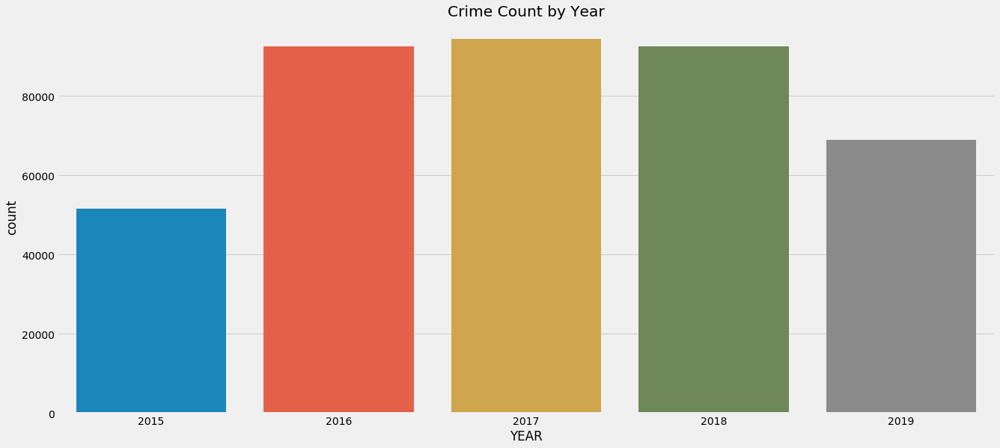

In [78]:
sns.countplot("YEAR", data = crime).set_title("Crime Count by Year")
print("min data date :", min(crime.occured_on_dttm)) 
print("max data date :", max(crime.occured_on_dttm))
print("Incomplete Year Data on 2015 & 2019")

In [79]:
# plotting Crime distribution by Day of Week and comparing the years

def week(Year):
    return sns.countplot("DAY_OF_WEEK",order=crime.DAY_OF_WEEK.value_counts().index, data = crime[crime.YEAR == Year]).set_title("Crime Distribution by Day of Week")
interactive(week,Year=(2015,2019,1))

#import matplotlib.pyplot as plt
#import matplotlib.animation as animation
#fig = plt.figure()
#sns.set_palette("pastel")
#def init():
#    sns.countplot("DAY_OF_WEEK",order=crime.DAY_OF_WEEK.value_counts().index, data = crime[crime.YEAR])

#anim = animation.FuncAnimation(fig, init_func=init, frames=5, repeat = False)$


interactive(children=(IntSlider(value=2017, description='Year', max=2019, min=2015), Output()), _dom_classes=(…

In [80]:
#plotting Crime Distribution by hour
#result = starts from 7AM & Peaks in the Afternoon (4pm to 7pm) -- this is true across all 4 years

#2k15
def hour(Year):
    return sns.countplot("HOUR", data =  crime[crime.YEAR == Year]).set_title("Crime Distribution by Hour")
interactive(hour,Year=(2015,2019,1))

interactive(children=(IntSlider(value=2017, description='Year', max=2019, min=2015), Output()), _dom_classes=(…

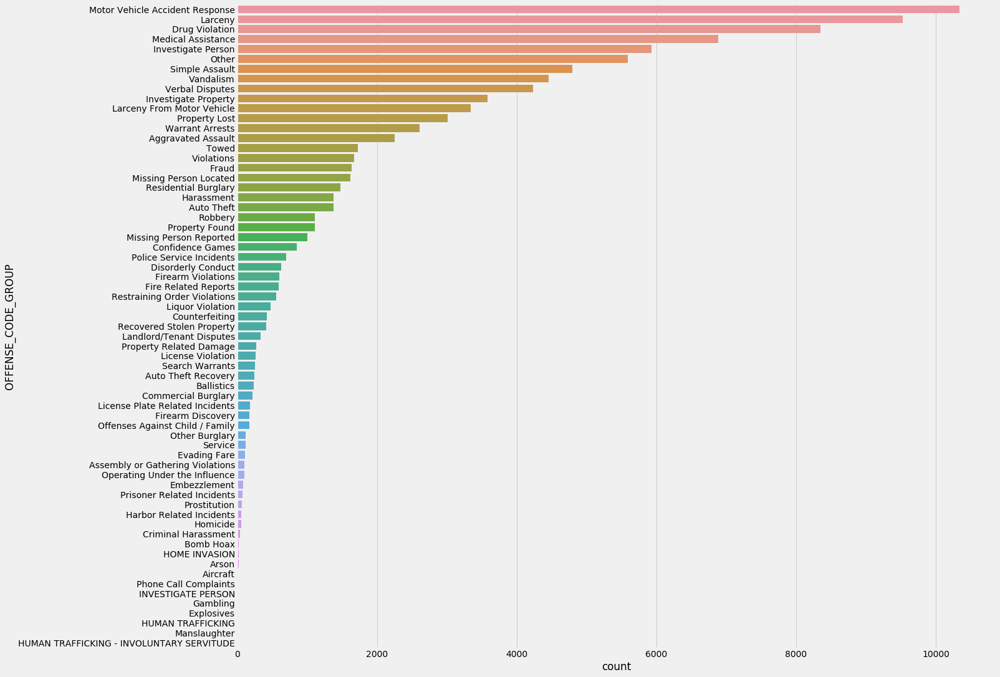

In [85]:
##Offense Group During Peak Time (4pm to 7 pm, 11pm to 12am)
hr = crime[(crime.HOUR >= 16) & (crime.HOUR <=19) | (crime.HOUR >= 23) &(crime.HOUR <=0)]

sns.catplot(y='OFFENSE_CODE_GROUP',
           kind='count',
            height=15, 
            aspect=1.5,
            order=hr.OFFENSE_CODE_GROUP.value_counts().index,
           data=hr)

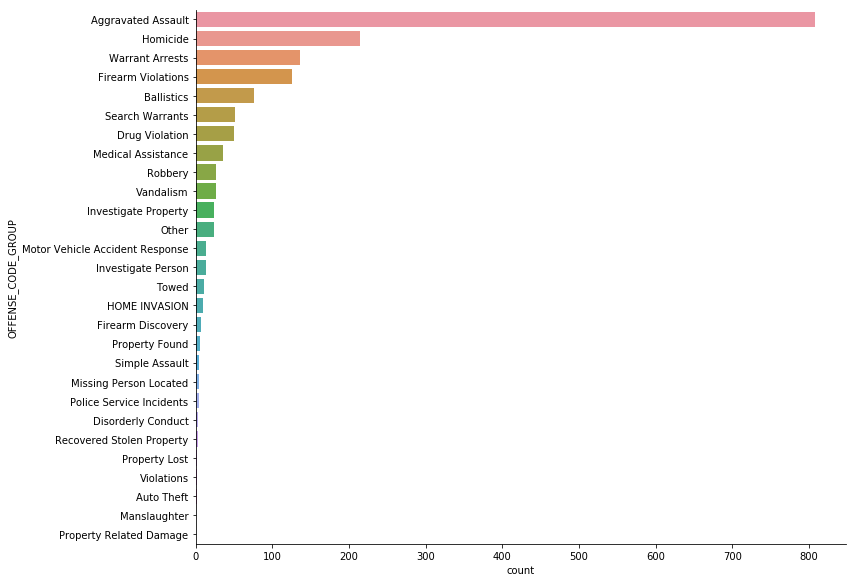

In [8]:
#type of offense code where there is shootings
shtgs = crime[crime.SHOOTING == 1]


sns.catplot(y='OFFENSE_CODE_GROUP',
           kind='count',
            height=8, 
            aspect=1.5,
            order=shtgs.OFFENSE_CODE_GROUP.value_counts().index,
           data=shtgs)

In [9]:
#Finding areas where there is more than 5 crime incidents
tmp = crime.groupby('INCIDENT_NUMBER')['YEAR'].count().sort_values(ascending = False)
tmp = pd.DataFrame({'INCIDENT_NUMBER': tmp.index, 'NUM_RECORDS': tmp.values})
seriousCrimes = crime.merge(tmp[tmp['NUM_RECORDS'] > 7], on = 'INCIDENT_NUMBER', how = 'inner')
seriousCrimes = seriousCrimes[['OFFENSE_CODE_GROUP','Lat','Long','NUM_RECORDS','STREET']].drop_duplicates()

Text(0.5, 1.0, 'Top Six Offense Group During Peak Time')

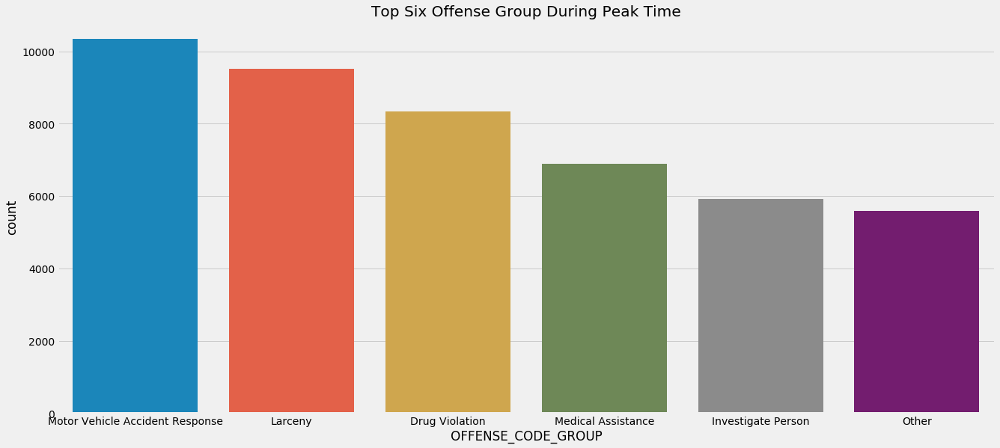

In [77]:
##Top Six Offense Group During Peak Time (4pm to 7 pm, 11pm to 12am)
hr = crime[(crime.HOUR >= 16) & (crime.HOUR <=19) | (crime.HOUR >= 23) &(crime.HOUR <=0)]
order = hr['OFFENSE_CODE_GROUP'].value_counts().head(6).index
sns.countplot(data = hr, x='OFFENSE_CODE_GROUP', order = order).set_title("Top Six Offense Group During Peak Time")

#plt.xticks(rotation=45)

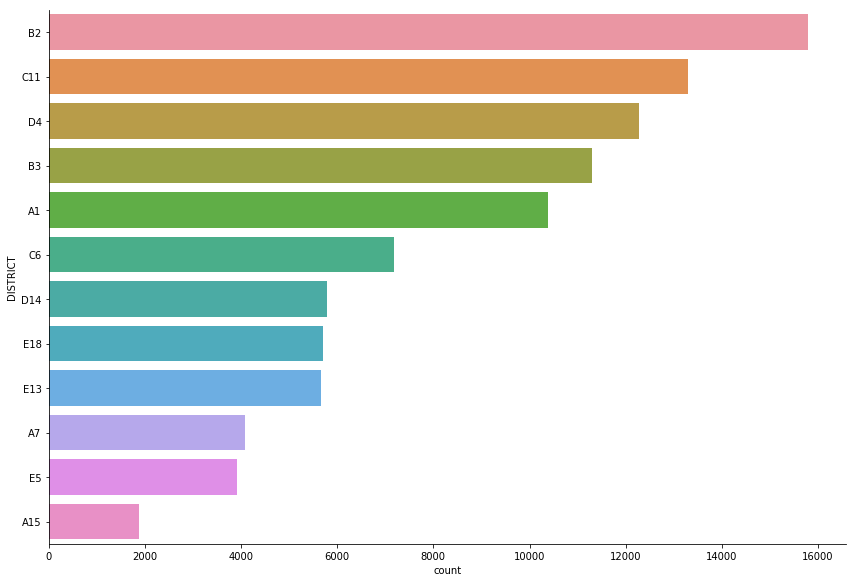

In [11]:
##Crime Count on DISTRICT During Peak Time (4pm to 7 pm, 11pm to 12am)
sns.catplot(y='DISTRICT',
           kind='count',
            height=8, 
            aspect=1.5,
            order=hr.DISTRICT.value_counts().index,
           data=hr)

AttributeError: 'interactive' object has no attribute 'legend'

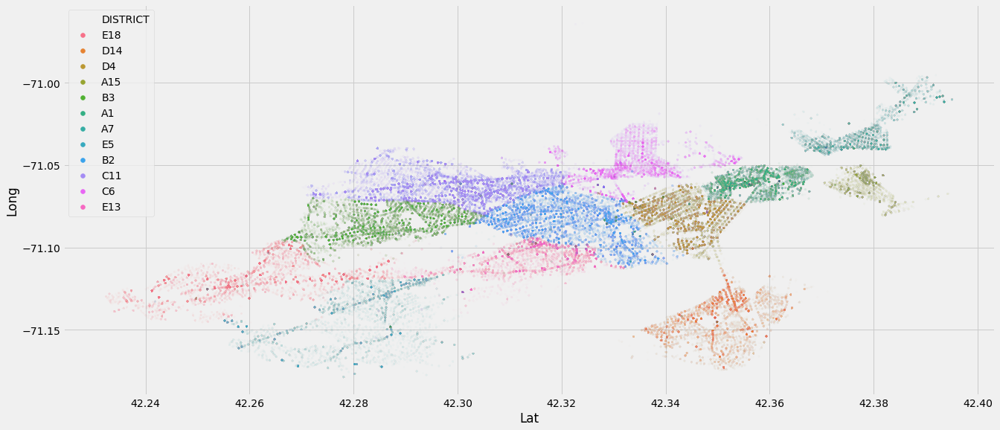

In [89]:
# replaces -1 values with None
crime.Lat.replace(-1,None,inplace=True)
crime.Long.replace(-1,None,inplace=True)

# identifies the distict where crime occur 
sns.scatterplot(x='Lat',y='Long', data=crime, alpha=0.01, hue='DISTRICT', s= 10)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2)
plt.show()

In [13]:
crime_freq=crime.groupby(['Lat', 'Long'],as_index=False).agg({"INCIDENT_NUMBER":"count"})

In [14]:
# Used this tutorial: https://medium.com/@bobhaffner/folium-markerclusters-and-fastmarkerclusters-1e03b01cb7b1
boston = folium.Map(location = [seriousCrimes['Lat'].mean(), 
                                  seriousCrimes['Long'].mean()], 
                      zoom_start = 12)
mc = MarkerCluster()
#creating a Marker for each point. 
for row in seriousCrimes.itertuples():
    mc.add_child(folium.Marker(location = [row.Lat, row.Long]))
boston.add_child(mc)

boston

In [15]:
###shooting data
shtng = crime[(crime.SHOOTING == 1) & (crime.DISTRICT.notnull())]

boston1 = folium.Map(location = [shtng['Lat'].mean(), 
                                  shtng['Long'].mean()], 
                      zoom_start = 12)
mc = MarkerCluster()
#creating a Marker for each point. 
for row in shtng.itertuples():
    mc.add_child(folium.Marker(location = [row.Lat,  row.Long]))

boston1.add_child(mc)

boston1

Additionals:

In [71]:
map_hooray = folium.Map(location=[42.340145,-71.057083],
                    zoom_start = 13, min_zoom=13) 

heatm = crime[crime['YEAR']==2017] 
heatm= heatm[heatm['OFFENSE_CODE_GROUP']=='Drug Violation']
heatm= heat_df[['Lat', 'Long']]


heat_data = [[row['Lat'],row['Long']] for index, row in heatm.iterrows()]
HeatMap(heat_data, radius=10).add_to(maphot)
maphot

In [68]:
maphot = folium.Map(location=[42.361145,-71.057083],
                    zoom_start = 12, min_zoom=12) 

heatm= crime[crime['YEAR']==2019]
heatm= heatm[heatm['OFFENSE_CODE_GROUP']=='Motor Vehicle Accident Response']
heatm= heatm[['Lat', 'Long']]


heat_data = [[row['Lat'],row['Long']] for index, row in heatm.iterrows()]
HeatMap(heat_data, radius=10).add_to(maphot)
maphot

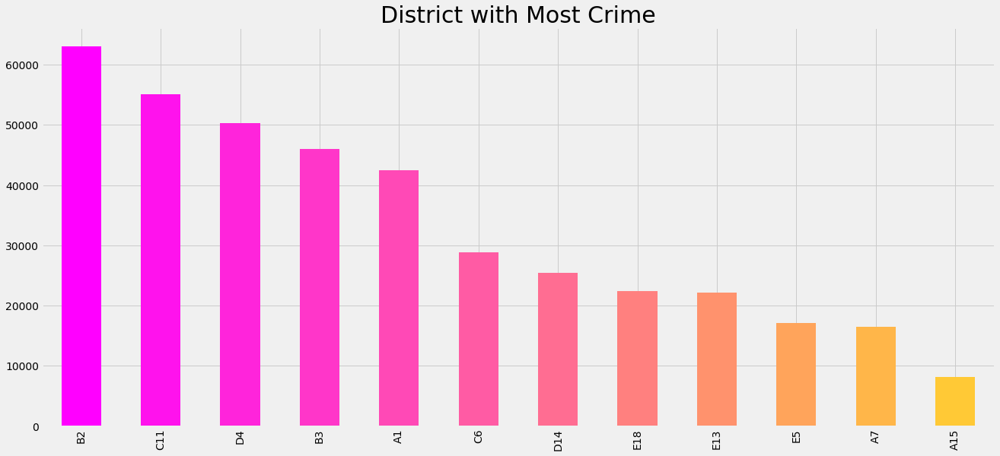

In [16]:
# District with most crime
plt.rcParams['figure.figsize'] = (20, 9)
plt.style.use('fivethirtyeight')

color = plt.cm.spring(np.linspace(0, 1, 15))
crime['DISTRICT'].value_counts().plot.bar(color = color)

plt.title('District with Most Crime',fontsize = 30)
plt.xticks(rotation = 90)
plt.show()

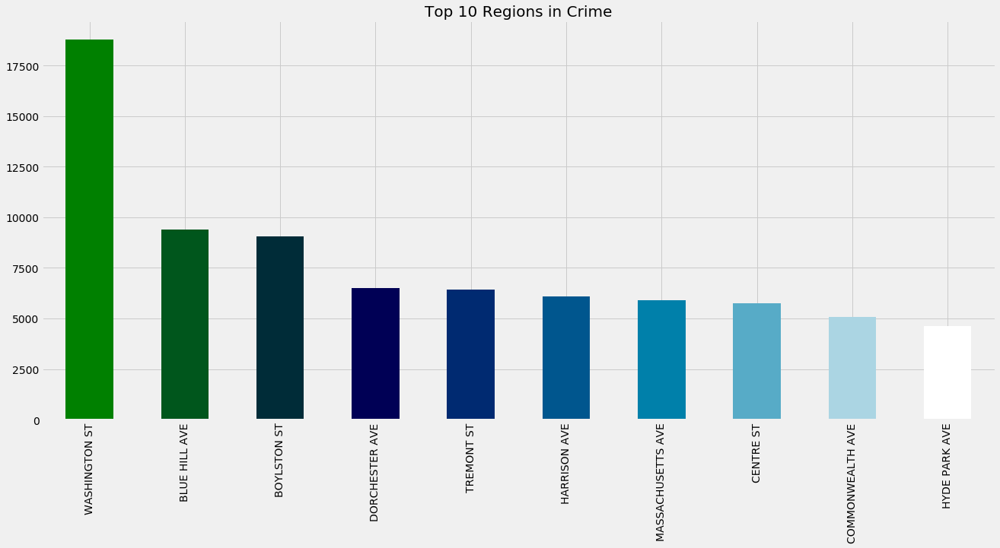

In [17]:
# top 15 streets with most crime
plt.rcParams['figure.figsize'] = (20, 9)
plt.style.use('fivethirtyeight')

color = plt.cm.ocean(np.linspace(0, 1, 10))
crime['STREET'].value_counts().head(10).plot.bar(color = color)

plt.title('Top 10 Street in Crime',fontsize = 20)
plt.xticks(rotation = 90)
plt.show()

In [18]:
def week(Year):
    return sns.countplot("DAY_OF_WEEK",order=crime.DAY_OF_WEEK.value_counts().index, data = crime[crime.YEAR == Year])
interactive(week,Year=(2015,2019,1))


interactive(children=(IntSlider(value=2017, description='Year', max=2019, min=2015), Output()), _dom_classes=(…

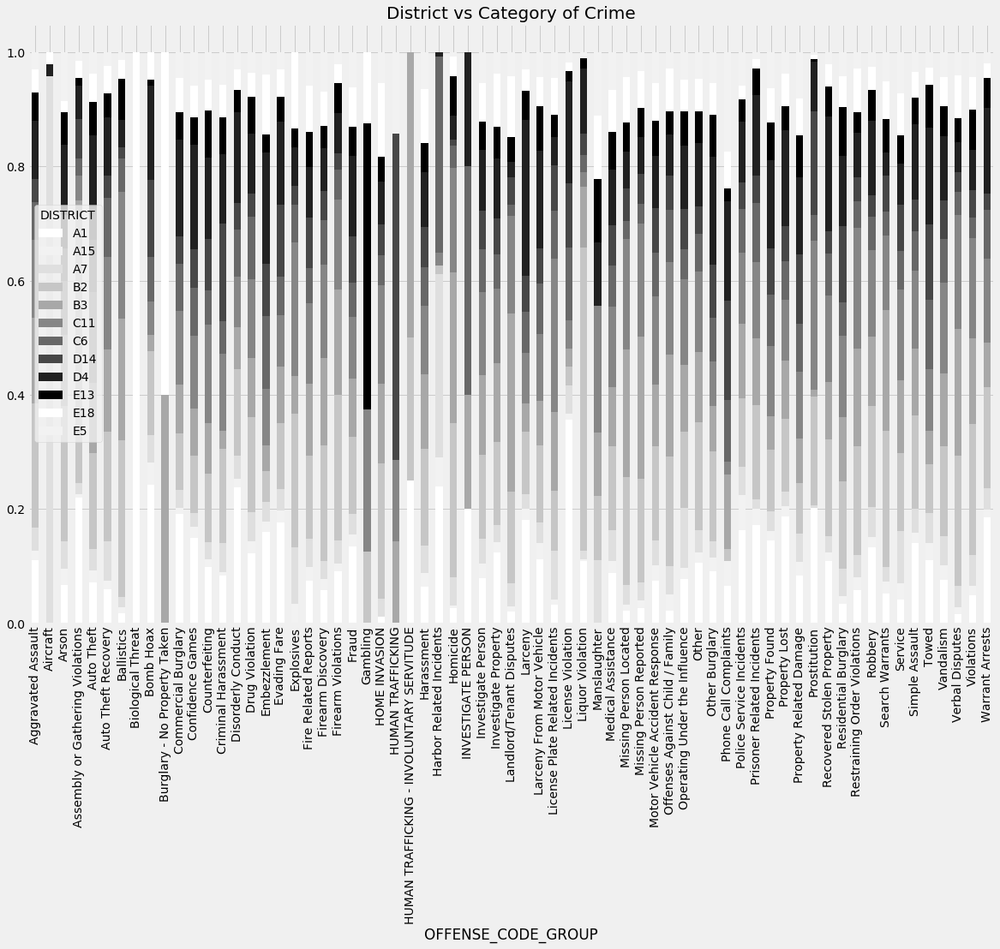

In [19]:
df = pd.crosstab(crime['OFFENSE_CODE_GROUP'], crime['DISTRICT'])
color = plt.cm.Greys(np.linspace(0, 1, 10))
df.div(df.sum(1).astype(float), axis = 0).plot.bar(stacked = True, color = color, figsize = (18, 12))
plt.title('District vs Category of Crime', fontweight = 30, fontsize = 20)
plt.xticks(rotation = 90)
plt.show()

In [57]:
#!pip install plotly
import plotly.graph_objects as go

x = crime.DAY_OF_WEEK
y = crime.HOUR

fig = go.Figure(go.Histogram2d(
        x=x,
        y=y
    ))
fig.show()

In [59]:
labels = crime.DAY_OF_WEEK.unique()
values=[]
for each in labels:
    values.append(len(crime[crime.DAY_OF_WEEK==each]))

# donut pie chart 
fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.3)])
fig.show()